In [ ]:
!pip install openpyxl

In [ ]:
!pip install econml

In [ ]:
!pip install shap

In [ ]:
import numpy as np
import pandas as pd
import scipy.stats
import sklearn
import xgboost
import shap


print("SHAP version:", shap.__version__)
print("XGBoost version:", xgboost.__version__)

SHAP version: 0.43.0
XGBoost version: 2.0.3


In [ ]:
import requests
import pandas as pd
from sklearn.preprocessing import StandardScaler
from io import StringIO

#https://drive.google.com/file/d/1e2NN1QE_TtygTDk8qnCZE0o9RHpJiz1z/view?usp=sharing
# Convert the shared link to a direct download link
file_id = '1e2NN1QE_TtygTDk8qnCZE0o9RHpJiz1z'
direct_link = f'https://drive.google.com/uc?id={file_id}'

# Use requests to get the content
response = requests.get(direct_link)
assert response.status_code == 200, 'Failed to download the file'

# Read the content into a DataFrame
from io import StringIO
data = StringIO(response.content.decode('utf-8'))
data = pd.read_csv(data)
# Data starts from the second column as per your original code
data = data[data.columns[1:]]
data.tail(30)
#1 Gliosarcom     , 0 Glioblastom

,X2,X3,X4,X5,X6,X7,X8,X9,X10,X11,...,X1301,X1302,X1303,X1304,X1305,X1306,X1307,X1308,A,Y
153,0.541117,18.728714,34.611240,31.320920,33.541020,36.619667,37.709415,28.737533,0.820383,3234.305586,...,4.701376,0.792453,4.812273,26.207547,0.494482,3.037736,43.042364,423.660377,1,1
154,0.697739,27.184592,38.960974,42.107007,34.205263,42.953463,43.886217,28.321671,0.783301,4513.071311,...,6.414893,0.804391,6.572999,258.177645,0.515325,11.271457,216.351042,3980.087824,1,1
155,0.735859,20.055480,27.254533,29.698485,29.698485,28.301943,32.031235,23.635658,0.785784,2526.138135,...,6.138486,0.663230,6.360928,103.790378,0.356668,9.474227,138.616242,2250.192440,1,1
156,0.671880,12.229290,18.201602,16.970563,16.970563,16.970563,20.784610,16.758607,0.913408,1005.950011,...,7.181562,0.838356,7.372911,423.008219,0.579463,9.468493,884.833147,19885.756164,1,1
157,0.713869,30.699834,43.004832,45.793013,40.804412,43.266615,49.477268,35.557865,0.837132,5952.372248,...,5.989067,0.828571,6.066469,77.700000,0.555000,3.628571,286.294439,2424.035714,1,1
158,0.745704,24.876791,33.360159,34.985711,36.124784,34.205263,38.065733,29.039951,0.825178,3772.962964,...,6.573676,0.723190,6.856166,453.933089,0.416071,28.651696,141.190196,2489.041247,1,1
159,0.793028,22.664197,28.579323,32.310989,32.310989,28.460499,33.541020,24.894139,0.820491,2903.728045,...,6.446668,0.833333,6.560827,140.015873,0.555619,5.007937,428.285132,4451.972222,1,1
160,0.741429,21.179339,28.565577,28.301943,30.000000,24.186773,32.449961,24.386438,0.879449,2637.235854,...,6.745632,0.656368,6.973656,475.284853,0.358165,37.251696,139.540344,1747.145441,1,1
161,0.650895,30.495852,46.852198,49.203658,45.694639,45.793013,51.701064,35.545371,0.765429,6675.440010,...,6.071384,0.608696,6.338088,191.418060,0.320097,24.979933,48.776949,509.374582,1,1
162,0.654918,35.413865,54.073751,52.478567,61.554854,57.314920,61.846584,48.634853,0.816474,9566.226346,...,5.985310,0.682836,6.119819,101.276119,0.377896,9.432836,79.917395,436.817164,1,1


In [ ]:
# Initialize the StandardScaler
scaler = StandardScaler()

# Fit the scaler to your data and transform it
scaled_data = scaler.fit_transform(data)

# Convert the scaled data back into a DataFrame
scaled_data_df = pd.DataFrame(scaled_data, columns=data.columns)

# Display the first few rows of the scaled DataFrame
print(scaled_data_df.head())

         X2        X3        X4        X5        X6        X7        X8  \
0 -1.838872 -0.451782  0.810619 -0.583505  0.729507  0.829244  0.660713   
1  0.203311  1.588779  1.145449  1.474658  1.500776  1.438215  1.273317   
2  0.335480  0.916049  0.500718  0.732883  0.950224  0.273821  0.718027   
3 -0.890571 -0.964823 -0.507822 -1.044772 -0.948094 -0.550772 -0.674908   
4  0.404254  0.126184 -0.179030  0.185618 -0.584984  0.074446 -0.126937   

         X9       X10       X11  ...     X1301     X1302     X1303     X1304  \
0 -0.167778 -0.696244  0.033709  ... -0.563230 -1.921599 -0.126598 -0.930114   
1  1.926718 -0.008739  1.860180  ...  0.388925  0.652361  0.297431 -0.539419   
2  0.671589 -0.240624  0.740052  ...  0.147443  1.012315 -0.290711 -0.915717   
3 -1.202348 -0.612291 -0.961454  ... -1.046860  0.457907 -1.156048 -1.004062   
4 -0.050781 -0.427276 -0.125321  ...  0.304474  0.576711  0.382114 -0.243299   

      X1305     X1306     X1307     X1308         A         Y  
0 -1

In [ ]:
import numpy as np
import sklearn.model_selection
import xgboost

params = {
    'eta': 0.1,  # Increased learning rate
    'subsample': 0.9,  # Using more of the data for each tree
    'max_depth': 7,  # Allowing trees to grow deeper
    'objective': 'binary:logistic',  # Assuming a binary classification problem
    'eval_metric': 'logloss',  # Can be changed to 'auc', 'error', etc., based on the problem
}

def fit_xgboost(X, y):
    """Train an XGBoost model with early stopping and print the accuracy."""
    X_train, X_test, y_train, y_test = sklearn.model_selection.train_test_split(X, y, test_size=0.2, random_state=42)
    dtrain = xgboost.DMatrix(X_train, label=y_train)
    dtest = xgboost.DMatrix(X_test, label=y_test)
    model = xgboost.train(
    params,
    dtrain,
    num_boost_round=1000,  # Starting with a reasonable number of rounds
    evals=[(dtest, "test")],
    early_stopping_rounds=50,  # Adjust based on validation set performance
    verbose_eval=True,  # Set to True to see the training progress
    )
    # Predict the probabilities
    y_pred_prob = model.predict(dtest)
    # Convert probabilities to binary predictions
    y_pred = np.where(y_pred_prob > 0.5, 1, 0)

    # Calculate the accuracy
    accuracy = np.sum(y_pred == y_test) / len(y_test)
    print(f"Model accuracy: {accuracy:.4f}")

    return model


[0]	test-logloss:0.65966
[1]	test-logloss:0.63470
[2]	test-logloss:0.60496
[3]	test-logloss:0.58942
[4]	test-logloss:0.56892
[5]	test-logloss:0.56193
[6]	test-logloss:0.56321
[7]	test-logloss:0.55911
[8]	test-logloss:0.56214
[9]	test-logloss:0.54608
[10]	test-logloss:0.54288
[11]	test-logloss:0.54702
[12]	test-logloss:0.54602
[13]	test-logloss:0.54366
[14]	test-logloss:0.54393
[15]	test-logloss:0.54000
[16]	test-logloss:0.53689
[17]	test-logloss:0.53176
[18]	test-logloss:0.51943
[19]	test-logloss:0.52699
[20]	test-logloss:0.52611
[21]	test-logloss:0.52456
[22]	test-logloss:0.53545
[23]	test-logloss:0.52831
[24]	test-logloss:0.52227
[25]	test-logloss:0.51264
[26]	test-logloss:0.50782
[27]	test-logloss:0.50795
[28]	test-logloss:0.51671
[29]	test-logloss:0.51989
[30]	test-logloss:0.52822
[31]	test-logloss:0.52168
[32]	test-logloss:0.51462
[33]	test-logloss:0.51976
[34]	test-logloss:0.51658
[35]	test-logloss:0.51791
[36]	test-logloss:0.51875
[37]	test-logloss:0.52391
[38]	test-logloss:0.52

[12:38:33] WARNING: /workspace/src/c_api/c_api.cc:1240: Saving into deprecated binary model format, please consider using `json` or `ubj`. Model format will default to JSON in XGBoost 2.2 if not specified.
 13%|█▎        | 164/1308 [23:19<2:41:36,  8.48s/it]No/low signal found from feature 163 (this is typically caused by constant or near-constant features)! Cluster distances can't be computed for it (so setting all distances to 1).
No/low signal found from feature 164 (this is typically caused by constant or near-constant features)! Cluster distances can't be computed for it (so setting all distances to 1).
 79%|███████▉  | 1034/1308 [2:24:10<38:05,  8.34s/it]No/low signal found from feature 1033 (this is typically caused by constant or near-constant features)! Cluster distances can't be computed for it (so setting all distances to 1).
1309it [3:02:09,  8.36s/it]


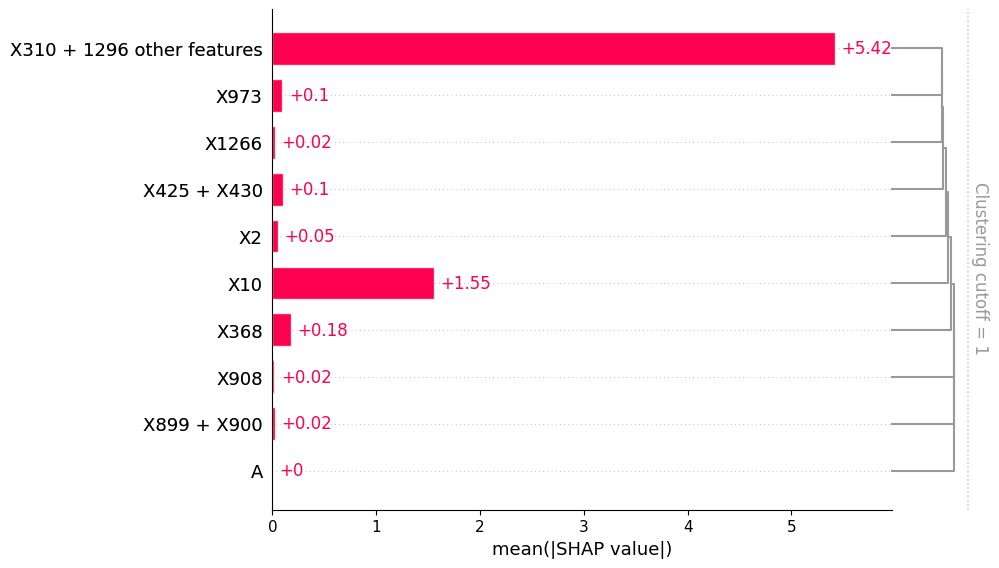

In [ ]:
y = data.Y
   # y = X_full["Did renew"]
X = data.drop(["Y"], axis=1)

model = fit_xgboost(X, y)
explainer = shap.Explainer(model)
shap_values = explainer(X)

clust = shap.utils.hclust(X, y, linkage="single")
shap.plots.bar(shap_values, clustering=clust, clustering_cutoff=1)

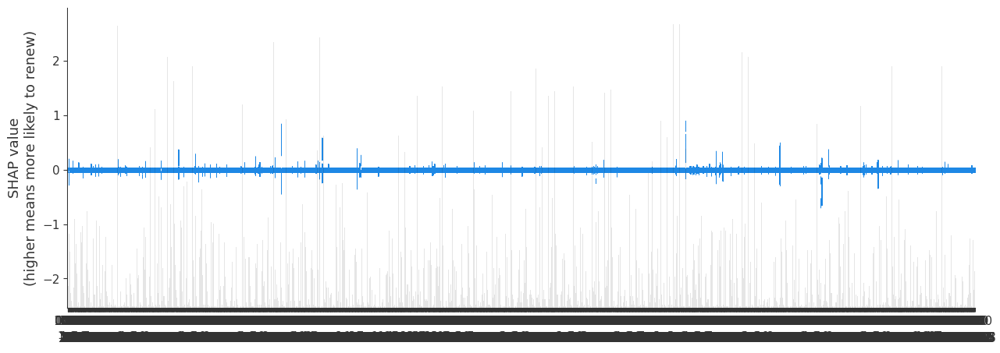

In [ ]:
#shap.plots.scatter(
#    shap_values, ylabel="SHAP value\n(higher means more likely to renew)"
#)


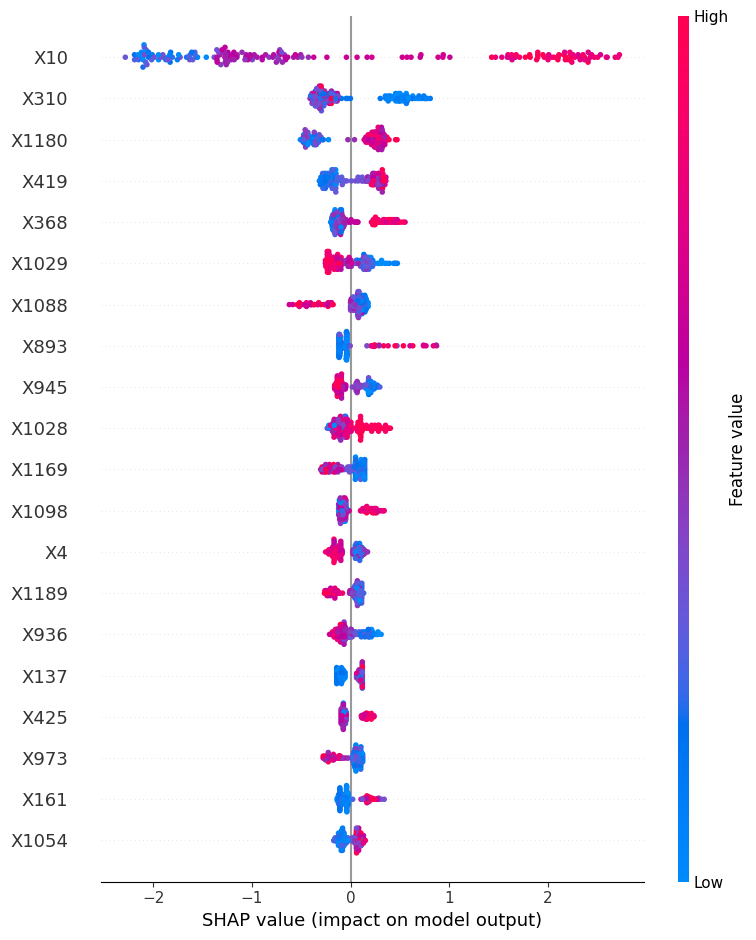

In [ ]:
shap.summary_plot(shap_values, features=X, feature_names=X.columns)

In [ ]:
columns = list(X.columns)
print(columns)

['X2', 'X3', 'X4', 'X5', 'X6', 'X7', 'X8', 'X9', 'X10', 'X11', 'X12', 'X13', 'X14', 'X15', 'X16', 'X17', 'X18', 'X19', 'X20', 'X21', 'X22', 'X23', 'X24', 'X25', 'X26', 'X27', 'X28', 'X29', 'X30', 'X31', 'X32', 'X33', 'X34', 'X35', 'X36', 'X37', 'X38', 'X39', 'X40', 'X41', 'X42', 'X43', 'X44', 'X45', 'X46', 'X47', 'X48', 'X49', 'X50', 'X51', 'X52', 'X53', 'X54', 'X55', 'X56', 'X57', 'X58', 'X59', 'X60', 'X61', 'X62', 'X63', 'X64', 'X65', 'X66', 'X67', 'X68', 'X69', 'X70', 'X71', 'X72', 'X73', 'X74', 'X75', 'X76', 'X77', 'X78', 'X79', 'X80', 'X81', 'X82', 'X83', 'X84', 'X85', 'X86', 'X87', 'X88', 'X89', 'X90', 'X91', 'X92', 'X93', 'X94', 'X95', 'X96', 'X97', 'X98', 'X99', 'X100', 'X101', 'X102', 'X103', 'X104', 'X105', 'X106', 'X107', 'X108', 'X109', 'X110', 'X111', 'X112', 'X113', 'X114', 'X115', 'X116', 'X117', 'X118', 'X119', 'X120', 'X121', 'X122', 'X123', 'X124', 'X125', 'X126', 'X127', 'X128', 'X129', 'X130', 'X131', 'X132', 'X133', 'X134', 'X135', 'X136', 'X137', 'X138', 'X139', '

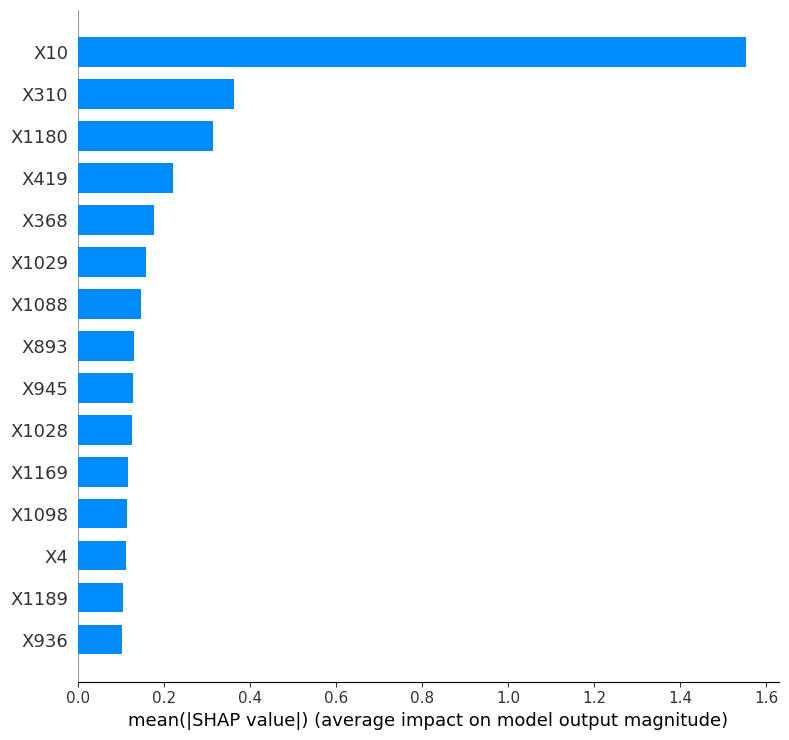

In [ ]:
import shap

# Then, you can pass the feature_names to shap.summary_plot
shap.summary_plot(shap_values, max_display=15, show=False, plot_type='bar', feature_names=columns)

In [ ]:
class FixableDataFrame(pd.DataFrame):
    """Helper class for manipulating generative models."""

    def __init__(self, *args, fixed={}, **kwargs):
        self.__dict__["__fixed_var_dictionary"] = fixed
        super().__init__(*args, **kwargs)

    def __setitem__(self, key, value):
        out = super().__setitem__(key, value)
        if isinstance(key, str) and key in self.__dict__["__fixed_var_dictionary"]:
            out = super().__setitem__(key, self.__dict__["__fixed_var_dictionary"][key])
        return out

In [ ]:
def intervention(data, fixed={}, seed=0):
  if seed is not None:
        np.random.seed(seed)
  X = FixableDataFrame(data.copy(), fixed=fixed)
  # Iterate over the fixed interventions and apply them
  for key, value in fixed.items():
      if key in X.columns:
          X[key] = value
  return X



In [ ]:
#intervention(data,fixed={'FANIN':2}).iloc[6, :]

X2          0.683218
X3         26.613810
X4         38.953588
X5         45.694639
X6         43.266615
            ...     
X1306      25.611521
X1307      88.969984
X1308    1920.734121
A           0.000000
Y           0.000000
Name: 6, Length: 1309, dtype: float64

testing marginal effects values

In [ ]:
def marginal_effects(data, columns=None, max_points=20, logit=True, seed=0):
    """Helper function to compute the true marginal causal effects."""
    X = intervention(data)
    if columns is None:
        columns = X.columns
    ys = [[] for _ in columns]
    xs = [X[c].values for c in columns]
    xs = np.sort(xs, axis=1)
    xs = [xs[i] for i in range(len(xs))]
    for i, c in enumerate(columns):
        xs[i] = np.unique(
            [
                np.nanpercentile(xs[i], v, method="nearest")
                for v in np.linspace(0, 100, max_points)
            ]
        )
        for x in xs[i]:
            Xnew = intervention(data, fixed={c: x}, seed=seed)
            Xnew = Xnew.drop(["Y"], axis=1)
            data_dmatrix = xgboost.DMatrix(Xnew)
            prediction = model.predict(data_dmatrix)
            val = prediction.mean()
            if logit:
                val = scipy.special.logit(val)
            ys[i].append(val)
        ys[i] = np.array(ys[i])
    ys = [ys[i] - ys[i].mean() for i in range(len(ys))]
    return list(zip(xs, ys))

In [ ]:
marginal_effects = marginal_effects(data)

In [ ]:
marginal_effects[0]

(array([0.12410706, 0.44483052, 0.51543339, 0.54111653, 0.56385386,
        0.58851984, 0.60561796, 0.61992109, 0.63823308, 0.65274891,
        0.66900126, 0.68080942, 0.69900857, 0.71326794, 0.72832832,
        0.74181405, 0.76866816, 0.79302776, 0.81687474, 0.88593589]),
 array([2.77555756e-17, 2.77555756e-17, 2.77555756e-17, 2.77555756e-17,
        2.77555756e-17, 2.77555756e-17, 2.77555756e-17, 2.77555756e-17,
        2.77555756e-17, 2.77555756e-17, 2.77555756e-17, 2.77555756e-17,
        2.77555756e-17, 2.77555756e-17, 2.77555756e-17, 2.77555756e-17,
        2.77555756e-17, 2.77555756e-17, 2.77555756e-17, 2.77555756e-17]))

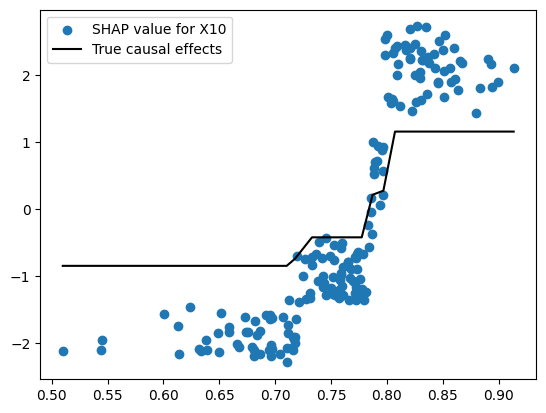

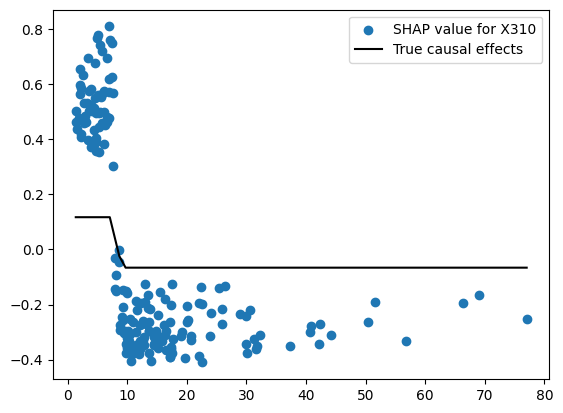

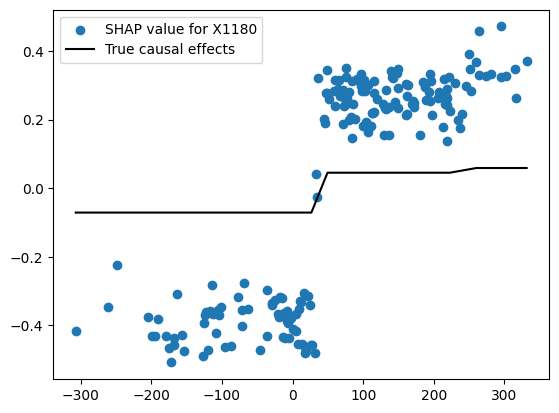

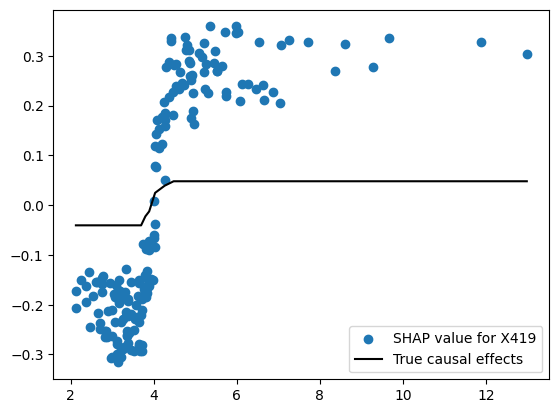

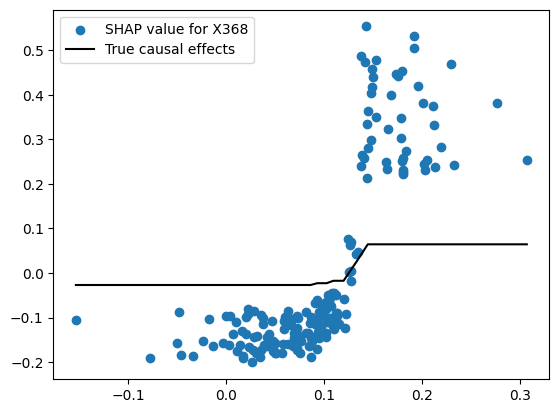

...

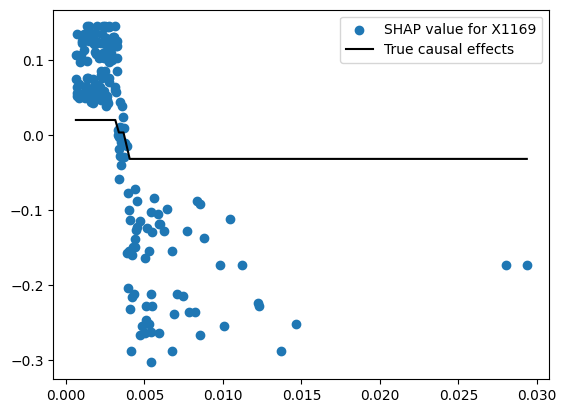

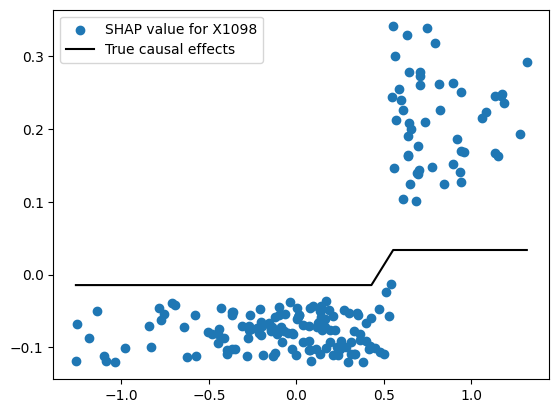

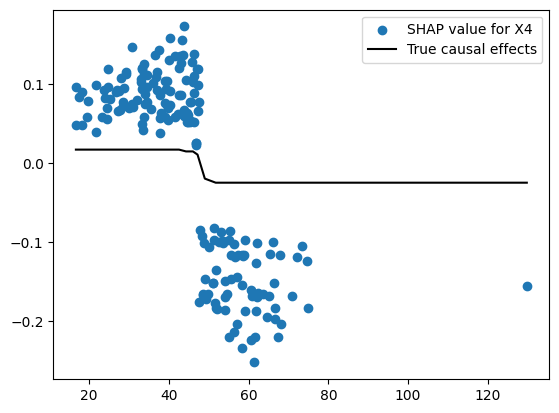

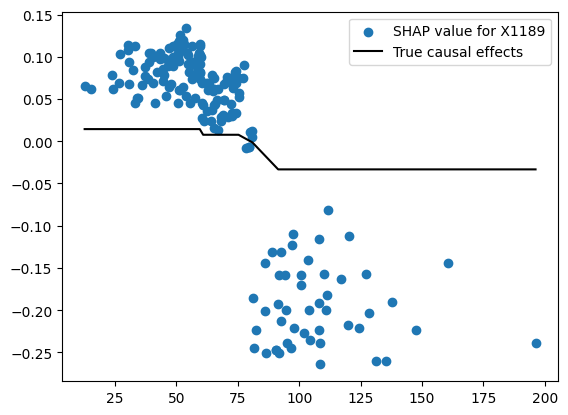

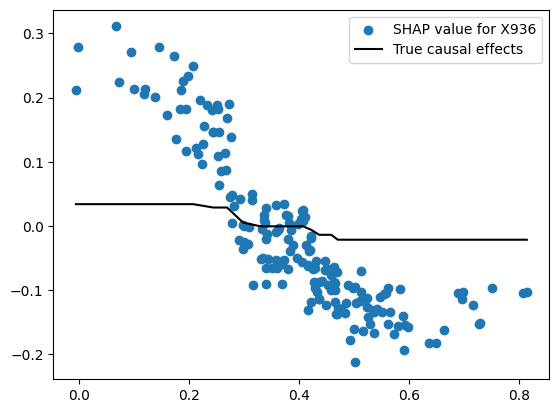

In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt

import shap
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'shap_values', 'data', 'marginal_effects', and 'columns' are defined

# Retrieve SHAP values in NumPy format
shap_array = shap_values.values if isinstance(shap_values, shap.Explanation) else shap_values

# Extract the top 15 feature indices based on SHAP importance
sorted_indices = np.argsort(np.mean(np.abs(shap_array), axis=0))[::-1][:15]
important_features = [columns[i] for i in sorted_indices]

# Filter SHAP values for the important features
filtered_shap_values = shap_array[:, sorted_indices]

# Plot scatter plots for each of the top 15 features and add the marginal effects
for i, feature in enumerate(important_features):
    # Get marginal effects corresponding to the feature
    marginal_effect = marginal_effects[sorted_indices[i]]
    x, y = marginal_effect  # Unpack x and y arrays from marginal effects

    # Create a scatter plot with overlay for the current feature

    plt.scatter(shap_values[:,sorted_indices[i]].data,shap_values[:,sorted_indices[i]].values ,label=f"SHAP value for {feature}")

    # # Plot true causal effects on top of the scatter plot
    plt.plot(x, y, color='black', label='True causal effects')
    plt.legend()
    plt.show()


### DoublML and DoWhy

In [ ]:
!pip install doubleml

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 256.4/256.4 kB 6.1 MB/s eta 0:00:00


In [ ]:
import pandas as pd
from doubleml import DoubleMLData, DoubleMLPLR
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.base import clone

# Assuming 'data' is your DataFrame and is already loaded with appropriate structure

try:
    dml_data = DoubleMLData(data, y_col='Y', d_cols='A')
except Exception as e:
    print("Error creating DoubleMLData:", e)

# Split the data into training and validation sets
df_train, df_test = train_test_split(data, test_size=0.3, random_state=123)

# Setup the DoubleML model with XGBoost
learner = XGBRegressor(n_estimators=100, random_state=123, use_label_encoder=False)
ml_g = clone(learner)  # model for the outcome equation
ml_m = clone(learner)  # model for the treatment equation

dml_plr = DoubleMLPLR(dml_data, ml_g, ml_m)

# Fit the DoubleML model
dml_plr.fit()

# Print the estimated causal effect
print("Estimated causal effect (Average Treatment Effect) of A on Y:")
try:
    print(dml_plr.summary())
except Exception as e:
    print("Error printing summary:", e)


Estimated causal effect (Average Treatment Effect) of A on Y:
Error printing summary: 'DataFrame' object is not callable


 Since the DoubleML model provides an overall effect rather than feature-specific causal effects, the way we overlay these results might differ from what your original code intended. If the original intent was to map feature-specific causal effects, please note that such direct mapping isn't typically available from DoubleML, which focuses on the treatment effect as a whole.

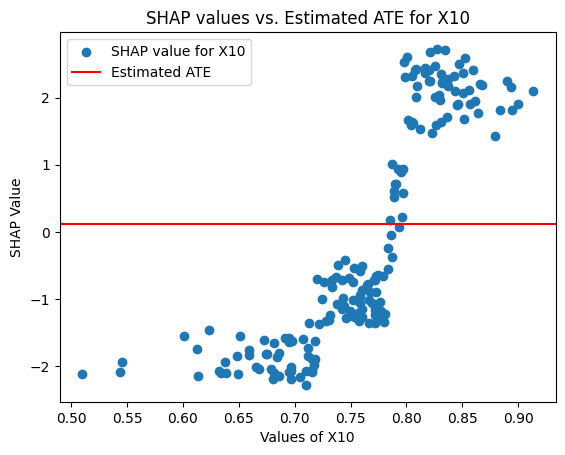

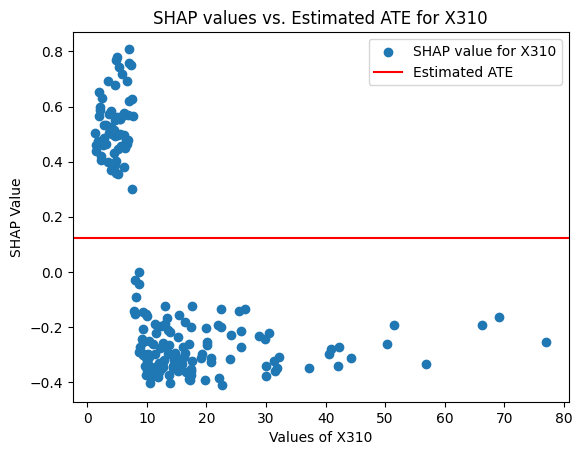

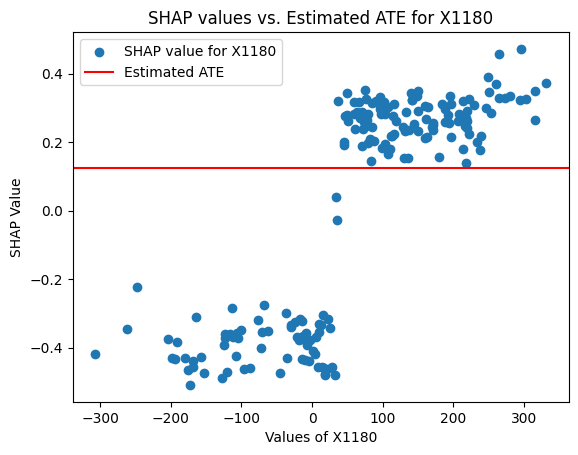

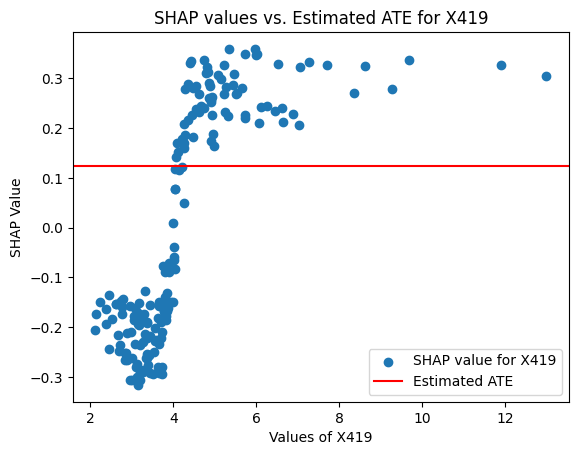

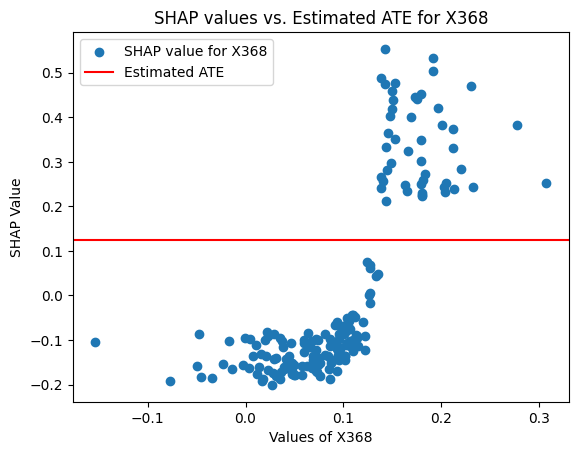

...

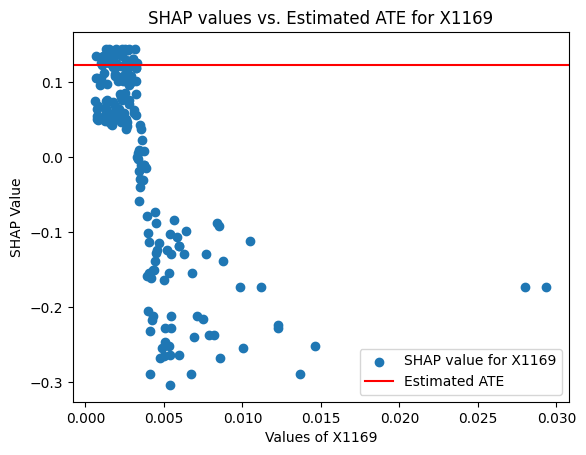

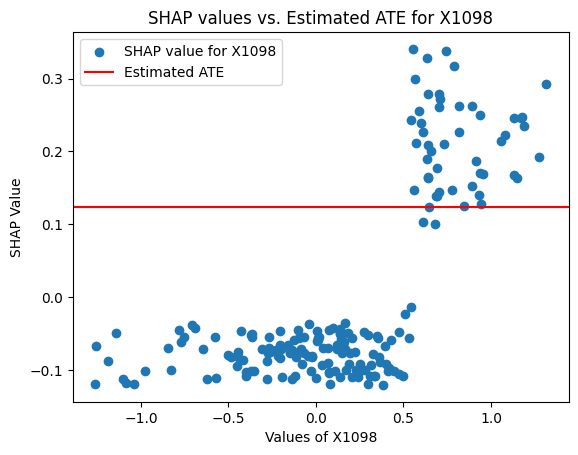

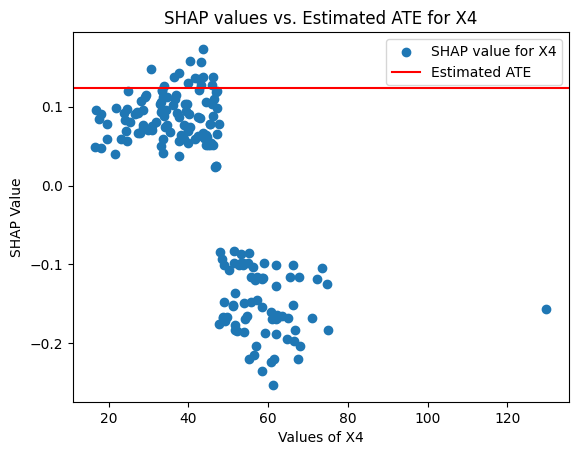

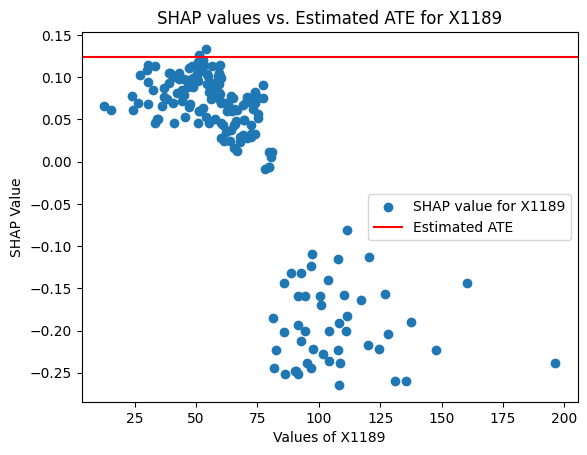

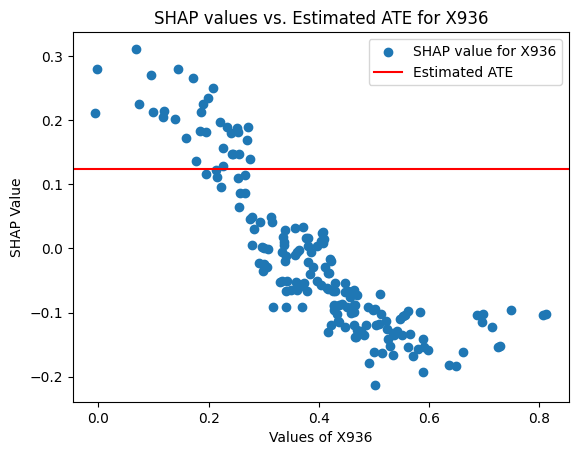

In [ ]:
import shap
import numpy as np
import matplotlib.pyplot as plt
from doubleml import DoubleMLData, DoubleMLPLR
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.base import clone

# Load data and setup DoubleML model (assuming this setup is already done)
# data = pd.read_csv('your_data.csv')
dml_data = DoubleMLData(data, y_col='Y', d_cols='A')
df_train, df_test = train_test_split(data, test_size=0.3, random_state=123)
learner = XGBRegressor(n_estimators=100, random_state=123, use_label_encoder=False)
ml_g = clone(learner)  # model for the outcome equation
ml_m = clone(learner)  # model for the treatment equation
dml_plr = DoubleMLPLR(dml_data, ml_g, ml_m)
dml_plr.fit()

# Assuming 'shap_values', 'data', and 'columns' are defined
# Retrieve SHAP values in NumPy format
shap_array = shap_values.values if isinstance(shap_values, shap.Explanation) else shap_values

# Extract the top 15 feature indices based on SHAP importance
sorted_indices = np.argsort(np.mean(np.abs(shap_array), axis=0))[::-1][:15]
important_features = [columns[i] for i in sorted_indices]

# Filter SHAP values for the important features
filtered_shap_values = shap_array[:, sorted_indices]

# ATE from DoubleML as the causal effect
ate = dml_plr.summary['coef'][0]  # assuming the first coefficient is ATE

# Plot scatter plots for each of the top 15 features
for i, feature in enumerate(important_features):
    plt.figure()
    plt.scatter(data[feature], filtered_shap_values[:, i], label=f"SHAP value for {feature}")
    plt.axhline(y=ate, color='r', linestyle='-', label='Estimated ATE')
    plt.title(f"SHAP values vs. Estimated ATE for {feature}")
    plt.xlabel(f"Values of {feature}")
    plt.ylabel("SHAP Value")
    plt.legend()
    plt.show()


## Beginning of the Total Variation

In [ ]:
def marginal_effects(data, columns=None, max_points=20, logit=True, seed=0):
    """Helper function to compute the true marginal causal effects."""
    X = intervention(data)
    if columns is None:
        columns = X.columns
    ys = [[] for _ in columns]
    xs = [X[c].values for c in columns]
    xs = np.sort(xs, axis=1)
    xs = [xs[i] for i in range(len(xs))]
    for i, c in enumerate(columns):
        xs[i] = np.unique(
            [
                np.nanpercentile(xs[i], v, method="nearest")
                for v in np.linspace(0, 100, max_points)
            ]
        )
        for x in xs[i]:
            Xnew = intervention(data, fixed={c: x}, seed=seed)
            Xnew = Xnew.drop(["Y"], axis=1)
            data_dmatrix = xgboost.DMatrix(Xnew)
            prediction = model.predict(data_dmatrix)
            val = prediction.mean()
            if logit:
                val = scipy.special.logit(val)
            ys[i].append(val)
        ys[i] = np.array(ys[i])
    ys = [ys[i] - ys[i].mean() for i in range(len(ys))]
    return list(zip(xs, ys))

In [ ]:
marginal_effects_data = marginal_effects(data)

In [ ]:
import numpy as np
from sklearn.neighbors import KernelDensity
from scipy.integrate import quad

# Function to fit KDE and return a probability density function
def fit_kde_and_get_pdf(column_data):
    # Reshape data for sklearn (it expects a 2D array)
    data = column_data.values.reshape(-1, 1)

    # Fit the KDE model
    kde = KernelDensity(kernel='gaussian', bandwidth=0.5).fit(data)

    # Define a function to represent the PDF using the KDE
    def pdf(x):
        return np.exp(kde.score_samples([[x]]))[0]

    return pdf

# Dictionary to hold the PDF functions for each column
pdf_functions = {}

for column in X:
    pdf_functions[column] = fit_kde_and_get_pdf(data[column])

# Now, pdf_functions contains a function for each column that computes the probability density.


In [ ]:
def PEACE(d):
  peace = {}
  for c in X.columns:
    index = X.columns.get_loc(c)
    effect = 0
    for i in range(1, len(marginal_effects_data[index][0])):
      effect += abs(marginal_effects_data[index][1][i] - marginal_effects_data[index][1][i-1])*(4*(pdf_functions[c](marginal_effects_data[index][0][i])*pdf_functions[c](marginal_effects_data[index][0][i-1]))**d)
    peace[c] = effect
  return peace

In [ ]:
import matplotlib.pyplot as plt

Print the 15 highest values

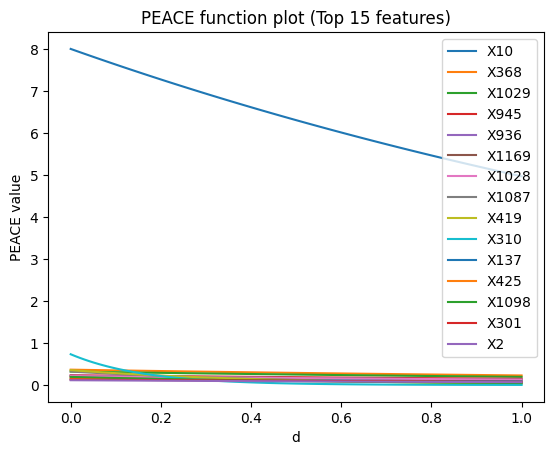

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assume that PEACE is a function that computes PEACE values for given d
d_values = np.linspace(0, 1, 100)
peace_values = {c: [] for c in X.columns}

# Compute PEACE(d) for each d value
for d in d_values:
    peace = PEACE(d)
    for c in peace:
        peace_values[c].append(peace[c])

# Compute the mean PEACE value for each feature
mean_peace_values = {c: np.mean(peace_values[c]) for c in peace_values}

# Get the top 15 features with the highest mean PEACE values
top_15_features = sorted(mean_peace_values, key=mean_peace_values.get, reverse=True)[:15]

# Plot the results for the top 15 features
for c in top_15_features:
    plt.plot(d_values, peace_values[c], label=c)

plt.xlabel('d')
plt.ylabel('PEACE value')
plt.title('PEACE function plot (Top 15 features)')
plt.legend()
plt.show()


complete plotting

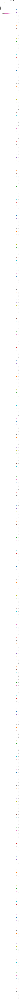

In [ ]:
d_values = np.linspace(0, 1, 100)
# Initialize a dictionary to hold the computed values
peace_values = {c: [] for c in X.columns}

# Compute PEACE(d) for each d value
for d in d_values:
    peace = PEACE(d)
    for c in peace:
        peace_values[c].append(peace[c])

# Plot the results
for c in peace_values:
    plt.plot(d_values, peace_values[c], label=c)

plt.xlabel('d')
plt.ylabel('PEACE value')
plt.title('PEACE function plot')
plt.legend()
plt.show()

15 highest features values plot

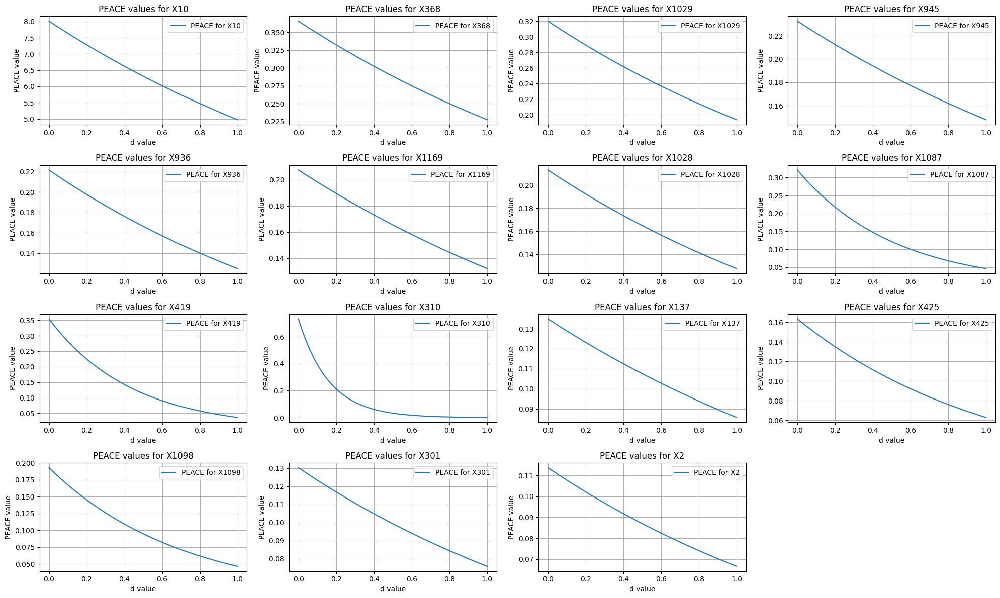

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Assume that 'peace_values' is a dictionary where keys are feature names and values are lists of PEACE values
# Compute the mean of each feature's PEACE values to determine the top 15 features
mean_peace = {k: np.mean(v) for k, v in peace_values.items()}
top_15_features = sorted(mean_peace, key=mean_peace.get, reverse=True)[:15]

# Create subplots with appropriate grid size
num_features = len(top_15_features)
num_rows = int(np.ceil(np.sqrt(num_features)))
num_cols = int(np.ceil(num_features / num_rows))

fig, axs = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 3 * num_rows))

# Flatten the axes array for easy indexing
axs = axs.flatten()

# Plot only the top 15 features
for i, c in enumerate(top_15_features):
    ax = axs[i]
    ax.plot(d_values, peace_values[c], label=f'PEACE for {c}')
    ax.set_xlabel('d value')
    ax.set_ylabel('PEACE value')
    ax.set_title(f'PEACE values for {c}')
    ax.legend()
    ax.grid(True)

# Hide any unused axes
for j in range(i + 1, num_rows * num_cols):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


Complete features plot

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

num_columns = len(X.columns)

# Calculate the grid size
num_rows = int(np.ceil(np.sqrt(num_columns)))
num_cols = int(np.ceil(num_columns / num_rows))

fig, axs = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 3 * num_rows))

# Flatten the axes array for easy indexing
axs = axs.flatten()

for i, (c, values) in enumerate(peace_values.items()):
    ax = axs[i]
    ax.plot(d_values, values, label=f'PEACE for {c}')
    ax.set_xlabel('d value')
    ax.set_ylabel('PEACE value')
    ax.set_title(f'PEACE values as a function of d for {c}')
    ax.legend()
    ax.grid(True)

# Hide any unused axes
for j in range(i + 1, num_rows * num_cols):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


In [ ]:
#  PEACE > 0.1
columns_with_values = {col: max(values) for col, values in peace_values.items() if any(value > 0.1 for value in values)}
formatted_columns_with_values = [f"{col},{value:.2f}" for col, value in columns_with_values.items()]

formatted_columns_with_values

['X2,0.11',
 'X4,0.17',
 'X10,8.01',
 'X137,0.13',
 'X161,0.15',
 'X186,0.10',
 'X273,0.13',
 'X301,0.13',
 'X310,0.73',
 'X368,0.37',
 'X419,0.35',
 'X425,0.16',
 'X893,0.51',
 'X936,0.22',
 'X945,0.23',
 'X973,0.17',
 'X1028,0.21',
 'X1029,0.32',
 'X1054,0.13',
 'X1087,0.32',
 'X1088,0.41',
 'X1098,0.19',
 'X1169,0.21',
 'X1180,0.52',
 'X1189,0.19']

In [ ]:
def positive(r):
  return max(r,0)

def PEACE_positive(d):
  peace_positive = {}
  for c in X.columns:
    index = X.columns.get_loc(c)
    effect = 0
    for i in range(1, len(marginal_effects_data[index][0])):
      effect += positive(marginal_effects_data[index][1][i] - marginal_effects_data[index][1][i-1])*((4*pdf_functions[c](marginal_effects_data[index][0][i])*pdf_functions[c](marginal_effects_data[index][0][i-1])**d))
    peace_positive[c] = effect
  return peace_positive

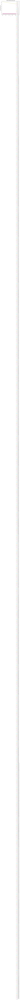

In [ ]:
# Initialize a dictionary to hold the computed values
peace_positive_values = {c: [] for c in X.columns}

# Compute PEACE(d) for each d value
for d in d_values:
    peace_positive = PEACE_positive(d)
    for c in peace:
        peace_positive_values[c].append(peace_positive[c])

# Plot the results
for c in peace_positive_values:
    plt.plot(d_values, peace_positive_values[c], label=c)

plt.xlabel('d')
plt.ylabel('Positive PEACE value')
plt.title('Positive PEACE function plot')
plt.legend()
plt.show()

In [ ]:
columns_with_values = {col: max(values) for col, values in peace_values.items()
                       if any(float(value) > 0.1 for value in values if isinstance(value, str) or isinstance(value, float))}
formatted_columns_with_values = [f"{col},{value:.2f}" for col, value in columns_with_values.items()]

formatted_columns_with_values


['X2,0.11',
 'X4,0.17',
 'X10,8.01',
 'X137,0.13',
 'X161,0.15',
 'X186,0.10',
 'X273,0.13',
 'X301,0.13',
 'X310,0.73',
 'X368,0.37',
 'X419,0.35',
 'X425,0.16',
 'X893,0.51',
 'X936,0.22',
 'X945,0.23',
 'X973,0.17',
 'X1028,0.21',
 'X1029,0.32',
 'X1054,0.13',
 'X1087,0.32',
 'X1088,0.41',
 'X1098,0.19',
 'X1169,0.21',
 'X1180,0.52',
 'X1189,0.19']

In [ ]:
def negative(r):
  return max(-r,0)

def PEACE_negative(d):
  peace_negative = {}
  for c in X.columns:
    index = X.columns.get_loc(c)
    effect = 0
    for i in range(1, len(marginal_effects_data[index][0])):
      effect += negative(marginal_effects_data[index][1][i] - marginal_effects_data[index][1][i-1])*((4*pdf_functions[c](marginal_effects_data[index][0][i])*pdf_functions[c](marginal_effects_data[index][0][i-1])**d))
      peace_negative[c] = effect
  return peace_negative

Highest 15 PEACE Negative values

All Negative PEACE values

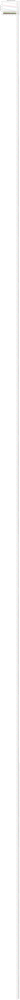

In [ ]:
# Initialize a dictionary to hold the computed values
peace_negative_values = {c: [] for c in X.columns}

# Compute PEACE(d) for each d value
for d in d_values:
    peace_negative = PEACE_negative(d)
    for c in peace:
        peace_negative_values[c].append(peace_negative[c])

# Plot the results
for c in peace_negative_values:
    plt.plot(d_values, peace_negative_values[c], label=c)

plt.xlabel('d')
plt.ylabel('Negative PEACE value')
plt.title('Negative PEACE function plot')
plt.legend()
plt.show()

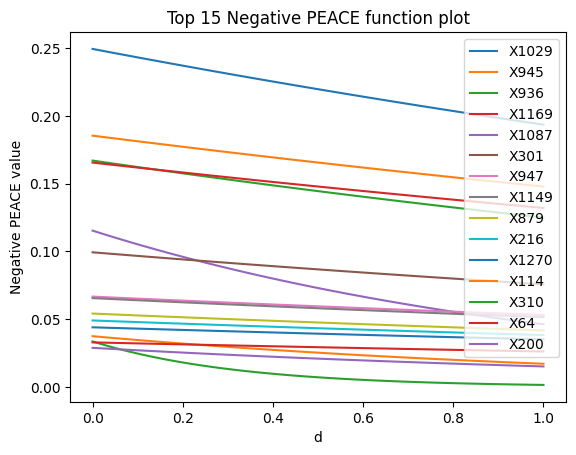

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Initialize a dictionary to hold the computed values
peace_negative_values = {c: [] for c in X.columns}

# Compute PEACE(d) for each d value
for d in d_values:
    peace_negative = PEACE_negative(d)
    for c in peace_negative:
        peace_negative_values[c].append(peace_negative[c])

# Compute the maximum PEACE value for each feature to determine the top 15 features
max_negative_peace = {k: max(v) for k, v in peace_negative_values.items()}
top_15_features = sorted(max_negative_peace, key=max_negative_peace.get, reverse=True)[:15]

# Plot only the top 15 features
for c in top_15_features:
    plt.plot(d_values, peace_negative_values[c], label=c)

plt.xlabel('d')
plt.ylabel('Negative PEACE value')
plt.title('Top 15 Negative PEACE function plot')
plt.legend()
plt.show()


In [ ]:
columns_with_values = {col: max(values) for col, values in peace_negative_values.items()
                       if any(float(value) > 0.1 for value in values if isinstance(value, str) or isinstance(value, float))}
formatted_columns_with_values = [f"{col},{value:.2f}" for col, value in columns_with_values.items()]

formatted_columns_with_values


['X936,0.17', 'X945,0.19', 'X1029,0.25', 'X1087,0.12', 'X1169,0.17']

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

num_columns = len(peace_positive_values.keys())

# Calculate grid dimensions
rows = int(np.sqrt(num_columns))
cols = int(np.ceil(num_columns / rows))

fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 3 * rows))
axs = axs.flatten()  # Flatten the array to make it easier to iterate over

for i, c in enumerate(peace_positive_values.keys()):
    # If num_columns is 1, axs is not an array
    ax = axs[i] if num_columns > 1 else axs
    ax.plot(d_values, peace_positive_values[c], label=f'Positive PEACE for {c}')
    ax.plot(d_values, peace_negative_values[c], label=f'Negative PEACE for {c}')
    ax.set_xlabel('d value')
    ax.set_ylabel('PEACE value')
    ax.set_title(f'PEACE values as a function of d for {c}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, rows * cols):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


15 highest positive and Negative

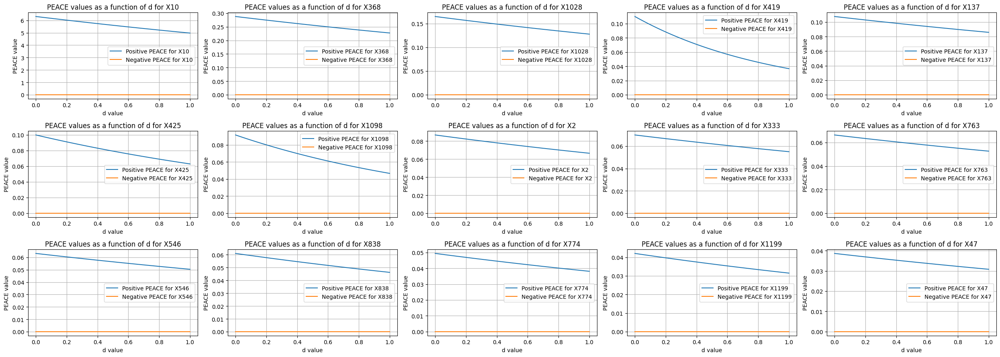

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


# Compute the maximum or mean value for each feature to find the top 15 features
max_positive_peace = {k: max(v) for k, v in peace_positive_values.items()}
top_15_features = sorted(max_positive_peace, key=max_positive_peace.get, reverse=True)[:15]

# Set up the grid dimensions for the plots
num_features = len(top_15_features)
rows = int(np.sqrt(num_features))
cols = int(np.ceil(num_features / rows))

fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 3 * rows))
axs = axs.flatten()  # Flatten the array to make it easier to iterate over

for i, c in enumerate(top_15_features):
    ax = axs[i]
    ax.plot(d_values, peace_positive_values[c], label=f'Positive PEACE for {c}')
    ax.plot(d_values, peace_negative_values[c], label=f'Negative PEACE for {c}')
    ax.set_xlabel('d value')
    ax.set_ylabel('PEACE value')
    ax.set_title(f'PEACE values as a function of d for {c}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, rows * cols):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


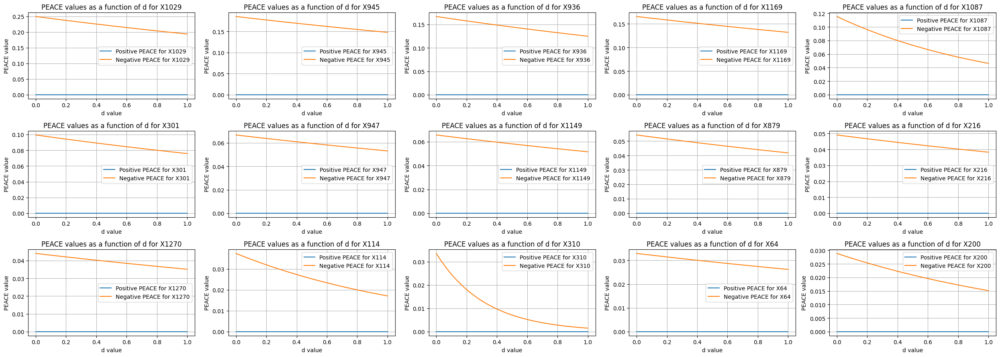

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


# Compute the maximum or mean value for each feature to find the top 15 features
max_negative_peace = {k: max(v) for k, v in peace_negative_values.items()}
top_15_features = sorted(max_negative_peace, key=max_negative_peace.get, reverse=True)[:15]

# Set up the grid dimensions for the plots
num_features = len(top_15_features)
rows = int(np.sqrt(num_features))
cols = int(np.ceil(num_features / rows))

fig, axs = plt.subplots(rows, cols, figsize=(5 * cols, 3 * rows))
axs = axs.flatten()  # Flatten the array to make it easier to iterate over

for i, c in enumerate(top_15_features):
    ax = axs[i]
    ax.plot(d_values, peace_positive_values[c], label=f'Positive PEACE for {c}')
    ax.plot(d_values, peace_negative_values[c], label=f'Negative PEACE for {c}')
    ax.set_xlabel('d value')
    ax.set_ylabel('PEACE value')
    ax.set_title(f'PEACE values as a function of d for {c}')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, rows * cols):
    axs[j].axis('off')

plt.tight_layout()
plt.show()
